## Geo3D Gold Deposits Prediction Model on Sumbawa, Indonesia

The PyGMTSAR InSAR library, Geomed3D Geophysical Inversion Library, N-Cube 3D/4D GIS Data Visualization, among others, are my open-source projects developed in my free time. I hold a Master's degree in STEM, specializing in radio physics. In 2004, I received the first prize in the All-Russian Physics Competition for significant results in forward and inverse modeling for nonlinear optics and holography. These skills are also applicable to modeling Gravity, Magnetic, and Thermal fields, as well as satellite interferometry processing. With 20 years of experience as a data scientist and software developer, I have contributed to scientific and industrial development, working on government contracts, university projects, and with companies like LG Corp and Google Inc.

You can support my work on [Patreon](https://www.patreon.com/pechnikov), where I share updates on my projects, publications, use cases, examples, and other useful information. For research and development services and support, please visit my profile on the freelance platform [Upwork](https://www.upwork.com).

### Resources
- Google Colab Pro notebooks and articles on [Patreon](https://www.patreon.com/pechnikov),
- Google Colab notebooks on [GitHub](https://github.com),
- Docker Images on [DockerHub](https://hub.docker.com),
- Geological Models on [YouTube](https://www.youtube.com),
- VR/AR Geological Models on [GitHub](https://github.com),
- Live updates and announcements on [LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/).

© Alexey Pechnikov, 2024

$\large\color{blue}{\text{Hint: Use menu Cell} \to \text{Run All or Runtime} \to \text{Complete All or Runtime} \to \text{Run All}}$
$\large\color{blue}{\text{(depending of your localization settings) to execute the entire notebook}}$

## Google Colab Installation

In [ ]:
import sys
if 'google.colab' in sys.modules:
    !apt-get update > /dev/null && apt install gdal-bin > /dev/null
    !{sys.executable} -m pip install -q matplotlib >/dev/null
    !{sys.executable} -m pip install -q git+https://github.com/AlexeyPechnikov/geo3d.git >/dev/null

In [ ]:
if 'google.colab' in sys.modules:
    !apt install -y xvfb > /dev/null
    !{sys.executable} -m pip install pyvista xvfbwrapper > /dev/null
    import xvfbwrapper
    display = xvfbwrapper.Xvfb(width=800, height=600)
    display.start()

## Load and Setup Python Modules

In [ ]:
import xarray as xr
import rioxarray as rio
import geopandas as gpd
import numpy as np
import os

from matplotlib import cm, colors
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
# plotting modules
import pyvista as pv
# magic trick for white background
pv.set_plot_theme("document")
import panel
panel.extension('vtk')

In [ ]:
import geo3d

# Parameters

In [ ]:
# download data files
!git clone https://github.com/AlexeyPechnikov/geo3d.git

Cloning into 'geo3d'...
remote: Enumerating objects: 145, done.
remote: Counting objects: 100% (69/69), done.
remote: Compressing objects: 100% (53/53), done.
remote: Total 145 (delta 25), reused 55 (delta 15), pack-reused 76
Receiving objects: 100% (145/145), 175.83 MiB | 14.94 MiB/s, done.
Resolving deltas: 100% (53/53), done.
Updating files: 100% (39/39), done.


In [ ]:
DEPTH=10000

# decimate to smaller grid
SCALE = 30

GAMMA1=3000
GAMMA2=5000

DEM = 'geo3d/data/ref/DSM.WestSumbawa.15m.32750.nc'
# initially, I shared the samples on GitHub:
# https://github.com/mobigroup/gis-snippets/tree/master/AU%20Prediction%20(ML)
SAMPLES = 'geo3d/data/ref/samples_synthetic_3class.WestSumbawa.geojson'
EPSG = 32750

## Prepare Reference Data

In [ ]:
dem = rio.open_rasterio(DEM).squeeze()\
    .coarsen({'y': SCALE, 'x': SCALE}, boundary='trim').mean()\
    .sel(x=slice(475000,535000), y=slice(9050000,9000000))
dem.values[dem.values==0] = np.nan
resolution = dem.x.diff('x')[0].round().item()
# add offset for visualization
dem.values += resolution
yy, xx = xr.broadcast(dem.y, dem.x)
vtk_grid = pv.StructuredGrid(xx.values, yy.values, dem.values)
vtk_grid['dem'] = dem.values.ravel(order='F')
vtk_grid.save('geo3d/data/processed/dem.WestSumbawa.vtk')

In [ ]:
classes = gpd.read_file(SAMPLES).to_crs(EPSG)
classes = classes[classes['class']==2]
classes = classes.assign(x=classes.geometry.x, y=classes.geometry.y)
classes['dem'] = dem.interp(x=xr.DataArray(classes.x.values), y=xr.DataArray(classes.y.values))
points = classes[['x', 'y', 'dem']].values
grid = pv.PolyData(points)
grid.save('geo3d/data/processed/samples_synthetic_3class_high.WestSumbawa.vtk')

## Load Raster

In [ ]:
raster0 = rio.open_rasterio(DEM).squeeze().astype(float)
raster0 = raster0.coarsen({'y': SCALE, 'x': SCALE}, boundary='trim').mean()
RESOLUTION = raster0.x.diff('x')[0].round().item()
print ('resolution', RESOLUTION)
if '_FillValue' in raster0.attrs:
    raster0.values[raster0.values==raster0._FillValue] = np.nan
raster0

resolution 450.0


<xarray.DataArray 'DSM' (y: 175, x: 200)>
array([[313.17666667, 270.36888889, 214.95888889, ...,  57.68666667,
         77.76333333,  56.85      ],
       [273.05777778, 231.39777778, 184.05333333, ...,  54.98444444,
         39.76555556,  24.38111111],
       [216.38666667, 193.48111111, 149.03444444, ...,  49.91222222,
         48.08777778,  21.24888889],
       ...,
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]])
Coordinates:
    band         int64 1
  * x            (x) float64 4.596e+05 4.601e+05 ... 5.487e+05 5.492e+05
  * y            (y) float64 9.063e+06 9.063e+06 ... 8.985e+06 8.985e+06
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:           Area
    offsets:                 0
    scales:                  1
    TIFFTAG_RESOLUTIONUNIT:  1 (unitless)
    TIFFTAG_XRESOLUTION:     1
    TIFFTAG_YRESOLUTION:     1
    _FillValue:              nan
    scale_factor:            1.0
    add_offset:              0.0

## Load DEM

In [ ]:
dem = rio.open_rasterio(DEM).squeeze().astype(float)\
    .coarsen({'y': SCALE, 'x': SCALE}, boundary='trim').mean()
if '_FillValue' in dem.attrs:
    dem.values[dem.values==dem._FillValue] = np.nan

## Gaussian Filtering

In [ ]:
raster = geo3d.geo3d.gaussian_range(raster0, GAMMA1/RESOLUTION, GAMMA2/RESOLUTION, backward=True)

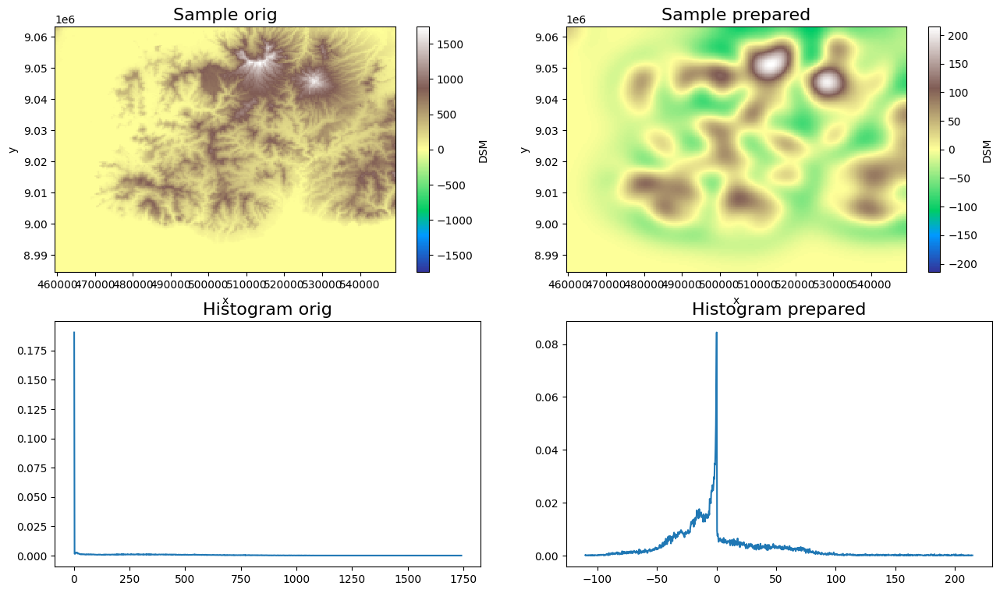

In [ ]:
fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2, 2, figsize=(15.5, 9))

raster0.plot(ax=ax1, cmap='terrain')
ax1.set_title('Sample orig',fontsize=16)

raster.plot(ax=ax2, cmap='terrain')
ax2.set_title('Sample prepared',fontsize=16)

hist, bin_edges = np.histogram(raster0, bins=1000, density=True,
                              range=(np.nanmin(raster0.values),np.nanmax(raster0.values)))
ax3.plot(bin_edges[1:],hist)
ax3.set_title('Histogram orig',fontsize=16)

hist, bin_edges = np.histogram(raster, bins=1000, density=True,
                              range=(np.nanmin(raster.values),np.nanmax(raster.values)))
ax4.plot(bin_edges[1:],hist)
ax4.set_title('Histogram prepared',fontsize=16)

fig.subplots_adjust(hspace=0.2)
plt.show()

## Make Grid

In [ ]:
# xArray grid
df_grid = raster0.to_dataframe('orig')
df_grid['z'] = dem.to_dataframe('z')['z']
df_grid = df_grid.dropna().reset_index()
df_grid

,y,x,band,spatial_ref,orig,z
0,9062955.0,459615.0,1,0,313.176667,313.176667
1,9062955.0,460065.0,1,0,270.368889,270.368889
2,9062955.0,460515.0,1,0,214.958889,214.958889
3,9062955.0,460965.0,1,0,159.458889,159.458889
4,9062955.0,461415.0,1,0,123.024444,123.024444
...,...,...,...,...,...,...
34995,8984655.0,547365.0,1,0,0.000000,0.000000
34996,8984655.0,547815.0,1,0,0.000000,0.000000
34997,8984655.0,548265.0,1,0,0.000000,0.000000
34998,8984655.0,548715.0,1,0,0.000000,0.000000


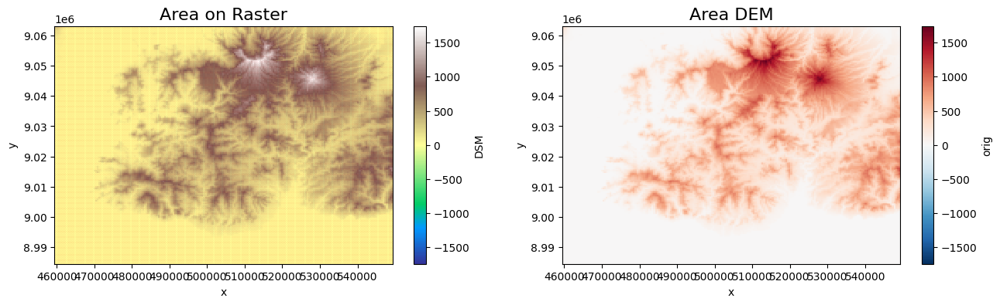

In [ ]:
fig, (ax1,ax2) = plt.subplots(1, 2, figsize=(15.5, 4))

raster0.plot(cmap='terrain', ax=ax1)
ax1.scatter(df_grid.x,df_grid.y, s=0.001, c='red')
ax1.set_title('Area on Raster',fontsize=16)

xr.Dataset.from_dataframe(df_grid.set_index(['y','x'])[['orig']]).orig.plot(ax=ax2)
ax2.set_title('Area DEM',fontsize=16)

fig.subplots_adjust(hspace=0.15)
plt.show()

## Calculate Statistics

In [ ]:
%%time
radius = int(round(DEPTH/(RESOLUTION*0.707),0))
ds3d = geo3d.geo3d.compute(raster, df_grid, radius)
ds3d

CPU times: user 9.38 s, sys: 341 ms, total: 9.72 s
Wall time: 9.93 s


<xarray.Dataset>
Dimensions:     (y: 175, x: 200, z: 31)
Coordinates:
  * y           (y) float64 8.985e+06 8.985e+06 ... 9.063e+06 9.063e+06
  * x           (x) float64 4.596e+05 4.601e+05 ... 5.487e+05 5.492e+05
  * z           (z) float64 1.273e+03 954.6 636.4 ... -7.955e+03 -8.273e+03
Data variables:
    density     (z, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    alteration  (z, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    anomaly     (z, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan

## Save to VTK files

In [ ]:
basename = os.path.splitext(os.path.basename(DEM))[0]
dx_km = np.diff(ds3d.x)[0]/1000
def filename(stat):
    return 'geo3d/data/processed/%s_gamma%.1fkm,%.1fkm.%s.vtk' % (basename,
                                                               dx_km*GAMMA1/RESOLUTION,
                                                               dx_km*GAMMA2/RESOLUTION,
                                                               stat)

In [ ]:
# use 3D cubes smoothing for better 3D plots
for stat in ds3d.data_vars:
    #print (stat)
    da = ds3d[stat]
    if stat == 'density':
        da_hist = da
    else:
        da_hist = geo3d.geo3d.crop_histogram(da)
    da_smooth = geo3d.geo3d.idw_filter(geo3d.geo3d.median_filter(da_hist))
    print ('Saving', stat, filename(stat))
    geo3d.vtk.da2vtk_scalar(da_smooth, filename(stat))

/usr/local/lib/python3.10/dist-packages/geo3d/geo3d.py:262: RuntimeWarning: invalid value encountered in divide
  arr_idw = np.nansum(w * da.values.flatten()[inds[:,1:]], axis=1) / \


Saving density geo3d/data/processed/DSM.WestSumbawa.15m.32750_gamma3.0km,5.0km.density.vtk


/usr/local/lib/python3.10/dist-packages/geo3d/geo3d.py:262: RuntimeWarning: invalid value encountered in divide
  arr_idw = np.nansum(w * da.values.flatten()[inds[:,1:]], axis=1) / \


Saving alteration geo3d/data/processed/DSM.WestSumbawa.15m.32750_gamma3.0km,5.0km.alteration.vtk


/usr/local/lib/python3.10/dist-packages/geo3d/geo3d.py:262: RuntimeWarning: invalid value encountered in divide
  arr_idw = np.nansum(w * da.values.flatten()[inds[:,1:]], axis=1) / \


Saving anomaly geo3d/data/processed/DSM.WestSumbawa.15m.32750_gamma3.0km,5.0km.anomaly.vtk


In [ ]:
# build interactive 3D plot
plotter = pv.Plotter(notebook=True)
axes = pv.Axes(show_actor=True, actor_scale=2.0, line_width=5)

grid = pv.read('geo3d/data/processed/dem.WestSumbawa.vtk').scale([1, 1, 2]).rotate_z(135, point=axes.origin)
plotter.add_mesh(grid, opacity=0.5, cmap='viridis', ambient=0, scalars='dem')

grid = pv.read('geo3d/data/processed/samples_synthetic_3class_high.WestSumbawa.vtk').scale([1, 1, 2]).rotate_z(135, point=axes.origin)
plotter.add_mesh(grid, opacity=1, color='red', ambient=1)

grid = pv.read(filename('anomaly')).scale([1, 1, 2]).rotate_z(135, point=axes.origin)
#plotter.add_mesh(grid.outline(), color="k")
contours = grid.contour(isosurfaces=[40,50,60,70], scalars='anomaly')
plotter.add_mesh(contours, opacity=0.15, cmap='rainbow', ambient=0.1, scalars='anomaly', show_scalar_bar=True)

plotter.show_axes()
plotter.add_title('Gold Deposits Prediction Model on West Sumbawa', font_size=32)
#p.show(screenshot='intf.png', jupyter_backend='panel', return_viewer=True)
plotter._on_first_render_request()
panel.panel(
    plotter.render_window, orientation_widget=plotter.renderer.axes_enabled,
    enable_keybindings=False, sizing_mode='stretch_width', min_height=600
)

VTKRenderWindowSynchronized(vtkXOpenGLRenderWindow, color_mappers=[LinearColorMapper(id='fd8...], min_height=600, orientation_widget=True, sizing_mode='stretch_width')